In [16]:
!pip install holoviews

# To use interaction plot, it is necessary to install holoviews and hvplot.

In [17]:
!pip install hvplot

# Several libraries of Python needs to be imported to perform visulisation



In [18]:
import holoviews as hv
import hvplot.pandas 

In [19]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

# Now, I will create summary data by compiling data into two dataframes: one containing daily customer data (one row for each date); the other compiled from all of the .csv files into a dataframe of summary data (with a row for each store).

In [20]:
NumberOfCustomers_data = pd.read_csv('https://tinyurl.com/ChrisCoDV/001142694/DailyCustomers.csv', index_col=0)
print(NumberOfCustomers_data)
SpendOnStoreMarketing_data = pd.read_csv('https://tinyurl.com/ChrisCoDV/001142694/StoreMarketing.csv', index_col=0)
CostOfOverhead_data = pd.read_csv('https://tinyurl.com/ChrisCoDV/001142694/StoreOverheads.csv', index_col=0)
StoreSize_data = pd.read_csv('https://tinyurl.com/ChrisCoDV/001142694/StoreSize.csv', index_col=0)
NumberOfStaff_data = pd.read_csv('https://tinyurl.com/ChrisCoDV/001142694/StoreStaff.csv', index_col=0)
pd.plotting.register_matplotlib_converters()
NumberOfCustomers_data.index = pd.to_datetime(NumberOfCustomers_data.index)

summary_data = pd.DataFrame(index=NumberOfCustomers_data.columns)
summary_data['NumberOfCustomers'] = NumberOfCustomers_data.sum().values
summary_data['StoreMarketing'] = SpendOnStoreMarketing_data.values
summary_data['Staff'] =NumberOfStaff_data.values
summary_data['StoreSize'] = StoreSize_data.values
summary_data['Overhead'] = CostOfOverhead_data.values
summary_data['Expenditure'] = summary_data['StoreMarketing'] + summary_data['Overhead']

print(summary_data.head())
#print(summary_data.describe())
print(NumberOfCustomers_data)


            TAP  NMO  BZM  VSM  ATT  RGS  ...  NAQ  WYG  BTB  YGY   SGA   SMM
Date                                      ...                                
2019-01-01   52    0   94   62   56  498  ...  463   79   66   84  1039   874
2019-01-02   78    0   74   87   70  490  ...  425   90   93   73  1076  1030
2019-01-03   74    0   73   59   48  468  ...  403   81   89   63   882  1028
2019-01-04   63    0   67   87   84  427  ...  358   90   74   79   819   807
2019-01-05   82    0   77   58   47  406  ...  359   85   83   80   878  1048
...         ...  ...  ...  ...  ...  ...  ...  ...  ...  ...  ...   ...   ...
2019-12-27   79   28   72   65   80  463  ...  394   81   78   80   866   859
2019-12-28   93    0   88   67   75  451  ...  386   87   81   86   887   836
2019-12-29   70    0   89   54   53  473  ...  424   88   92   63   982   995
2019-12-30   54  110   91   66   68  509  ...  433   84  110   82  1055   998
2019-12-31   77   67   97   56   62  525  ...  501   85   98   6

# Firstly, I want to sort the stores based on the number of customer visits and identify which stores have a higher number of the customer.

In [21]:
NumberOfCustomers_data = NumberOfCustomers_data.reindex(NumberOfCustomers_data.sum().sort_values(ascending=False).index, axis=1)
print(NumberOfCustomers_data.sum())
#print(NumberOfCustomers_data.head())


RAH    364346
SGA    354329
SMM    340300
QSN    303662
PAA    176224
RGS    172922
OSG    163389
QMD    158282
NAQ    153981
PGL    145653
OMV    125061
MUY    120250
EFN     32547
TSE     32121
WMB     31210
WYG     30842
BTB     29465
ENY     28812
TAP     28622
BZM     28271
YGY     28093
XML     27156
UMU     26026
CFG     25999
UGJ     25889
CNQ     24452
VSM     24427
DTJ     24089
ATT     23724
VYZ     23624
DZT     22472
WGR     21641
XSV     15657
NMO     14111
AEI     11467
ZMS     10804
NGB      8867
YYO      8134
ZSD      5380
MAJ      5248
dtype: int64


# Now, I will select the stores with a higher number of customers and create a line plot. I have not added this plot in the report as it only gives me information about the stores with a higher number of customer visits.


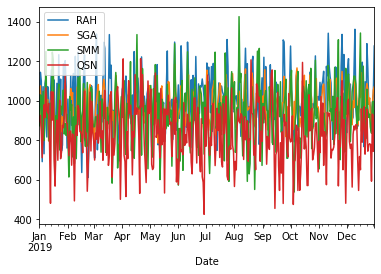

In [22]:
selectedHigh = ['RAH','SGA','SMM','QSN']
NumberOfCustomers_data1 = NumberOfCustomers_data[selected]

NumberOfCustomers_data1.plot.line()
plt.show()


# As the previous plot is noisy, limiting the x-axis, which is the date gives us a better view of the troughs and peaks. This is done for all the stores. However, I did not include it in the report as it has lesser information.


             RAH   SGA   SMM  QSN  PAA  RGS  ...  AEI  ZMS  NGB  YYO  ZSD  MAJ
Date                                         ...                              
2019-06-01  1081   923   573  576  412  429  ...   48   68    0    0    0    0
2019-06-02   912   947   860  719  481  442  ...   52   73    0    0    0    0
2019-06-03   972   965   695  860  536  488  ...   18   57    0    0    0    0
2019-06-04  1279  1077   861  743  517  505  ...    0   60    0    0    0    0
2019-06-05  1125  1052  1103  752  547  511  ...  214   57    0    0    0    0

[5 rows x 40 columns]


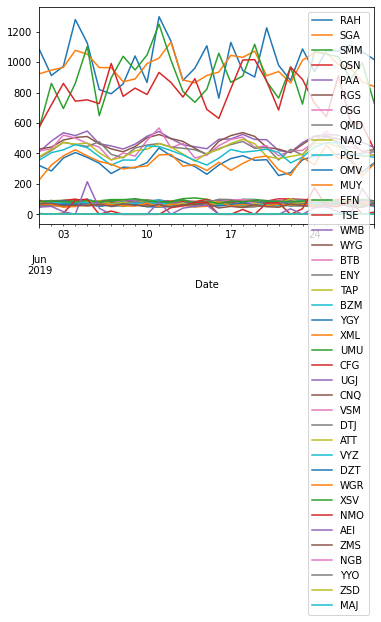

In [23]:
NumberOfCustomers_data.index = pd.to_datetime(NumberOfCustomers_data.index)

NumberOfCustomers_data2 = NumberOfCustomers_data.loc[pd.to_datetime('2019-06-01'): pd.to_datetime('2019-06-29')]
print(NumberOfCustomers_data2.head())

NumberOfCustomers_data2.plot.line()
plt.show()


#Now, I am creating a bar chart to see the number of customers in the stores. However, this bar chart lacks the store's name, which is why I have not added it.


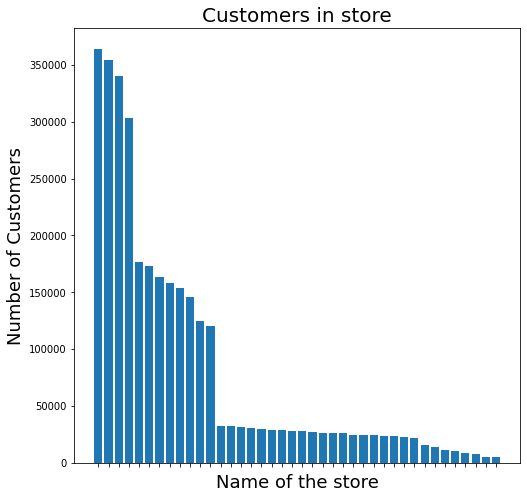

In [24]:
plt.figure(figsize=(8, 8))
x_pos = np.arange(len(NumberOfCustomers_data.columns))
plt.bar(x_pos, NumberOfCustomers_data.sum(), align='center')
plt.xticks(x_pos, [])
plt.xlabel('Name of the store', fontsize=18)
plt.ylabel('Number of Customers', fontsize=18)
plt.title('Customers in store', fontsize=20)
plt.show()



#I am now selecting the stores that have a higher number of customers. I still have not added this as it is possible to add only 8 visualisations in the report. I thought it is too simple.


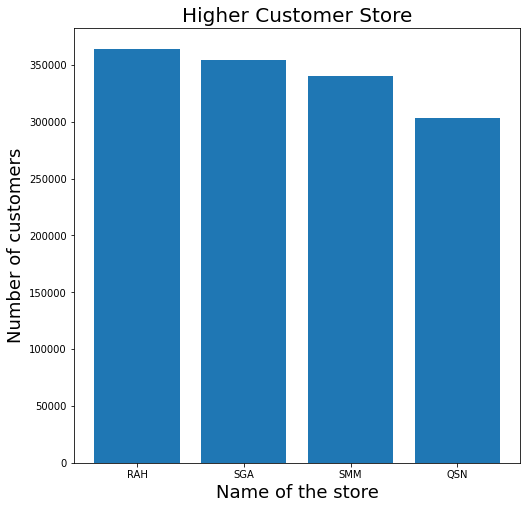

In [25]:
plt.figure(figsize=(8, 8))
x_pos = np.arange(len(NumberOfCustomers_data[selectedHigh].columns))
plt.bar(x_pos, NumberOfCustomers_data[selected].sum(), align='center')
plt.xticks(x_pos, NumberOfCustomers_data[selected].columns)
plt.xlabel('Name of the store', fontsize=18)
plt.ylabel('Number of customers', fontsize=18)
plt.title('Higher Customer Store', fontsize=20)
plt.show()


#I am selecting the stores that have a medium number of customers. Again, this too simple to add.

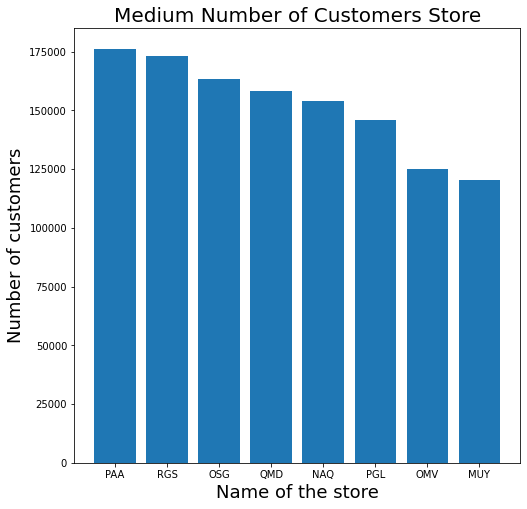

In [26]:
selectedMedium = ['PAA','RGS','OSG','QMD','NAQ','PGL','OMV','MUY']
plt.figure(figsize=(8, 8))
x_pos = np.arange(len(NumberOfCustomers_data[selectedMedium].columns))
plt.bar(x_pos, NumberOfCustomers_data[selectedMedium].sum(), align='center')
plt.xticks(x_pos, NumberOfCustomers_data[selectedMedium].columns)
plt.xlabel('Name of the store', fontsize=18)
plt.ylabel('Number of customers', fontsize=18)
plt.title('Medium Number of Customers Store', fontsize=20)
plt.show()

#I am selecting the stores that have a lower number of customers which is not mentioned in the report because the store names in the x-axis are overlapped.

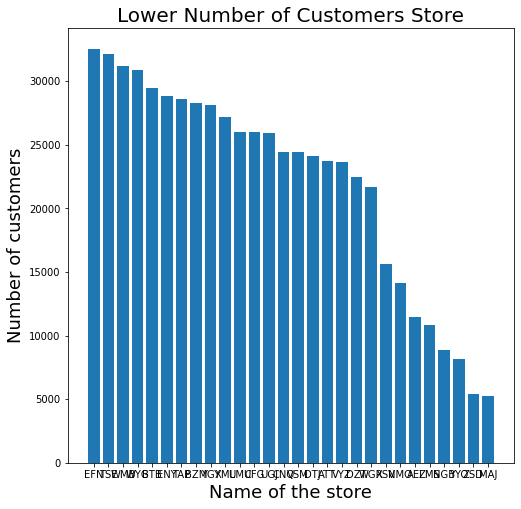

In [27]:
selectedLow = NumberOfCustomers_data.columns[NumberOfCustomers_data.sum() < 50000]
plt.figure(figsize=(8, 8))
x_pos = np.arange(len(NumberOfCustomers_data[selectedLow].columns))
plt.bar(x_pos, NumberOfCustomers_data[selectedLow].sum(), align='center')
plt.xticks(x_pos, NumberOfCustomers_data[selectedLow].columns)
plt.xlabel('Name of the store', fontsize=18)
plt.ylabel('Number of customers', fontsize=18)
plt.title('Lower Number of Customers Store', fontsize=20)
plt.show()


#I am creating a pie chart. However, as it does not reveal exact information, it has been excluded from the report.


             RAH   SGA   SMM  QSN  PAA  RGS  ...  QMD  NAQ  PGL  OMV  MUY  Others
Date                                         ...                                 
2019-01-01   938  1039   874  895  505  498  ...  452  463  443  409  358    1589
2019-01-02  1145  1076  1030  927  514  490  ...  506  425  409  351  397    1667
2019-01-03  1101   882  1028  845  464  468  ...  426  403  383  285  277    1574
2019-01-04   692   819   807  712  474  427  ...  436  358  360  326  231    1655
2019-01-05  1072   878  1048  852  428  406  ...  363  359  362  289  290    1609

[5 rows x 13 columns]


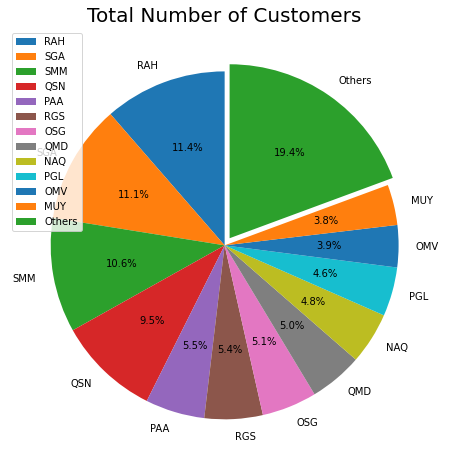

In [28]:
explodeList = []
selectedPie = []
columns = NumberOfCustomers_data.columns
NumberOfCustomers_data['Others'] = [0] * len(NumberOfCustomers_data.index)
for name in columns:
    total_NumberOfCustomers = NumberOfCustomers_data[name].sum()
    if total_NumberOfCustomers > 100000:
        selectedPie.append(name)
        explodeList.append(0)
    else:
        NumberOfCustomers_data['Others'] += NumberOfCustomers_data[name]
selectedPie.append('Others')
explodeList.append(0.05)
print(NumberOfCustomers_data[selectedPie].head())

plt.figure(figsize=(8, 8))
plt.pie(NumberOfCustomers_data[selectedPie].sum(), labels=selectedPie, autopct='%1.1f%%', startangle=90, explode=explodeList)
plt.title('Total Number of Customers', fontsize=20)
plt.legend(loc=2)
plt.show()


#**Visualisation:1**
#I have included this visualisation as it portrays the stores with high, medium, low, and very low number of customers with respect to time.
 

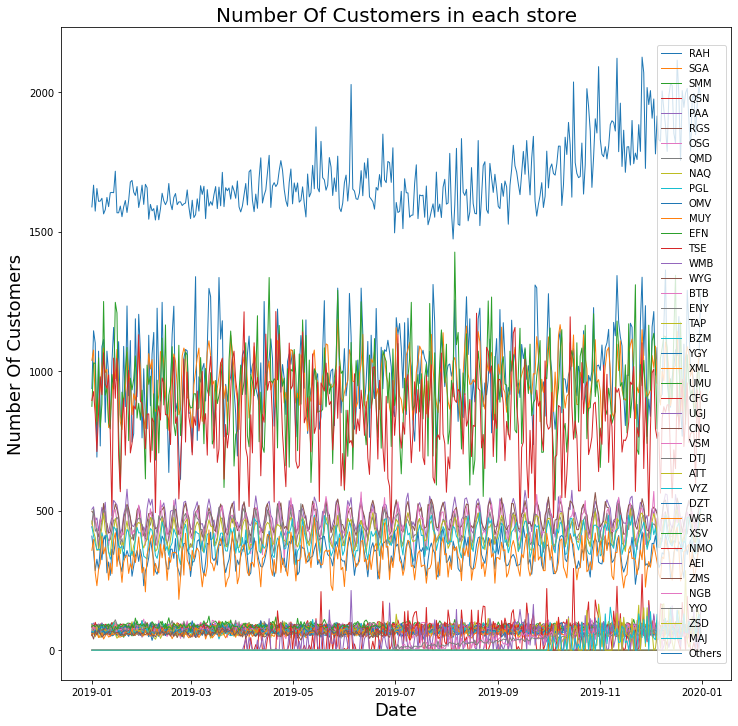

In [29]:
plt.figure(figsize=(12, 12))
plt.plot(NumberOfCustomers_data, linewidth=1)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Number Of Customers', fontsize=18)
plt.title('Number Of Customers in each store', fontsize=20)
plt.legend(NumberOfCustomers_data.columns, loc=5)
plt.show()


# I am plotting rolling average for 7 days for Higher number of Customers which is not added in the report as it is too noisy.


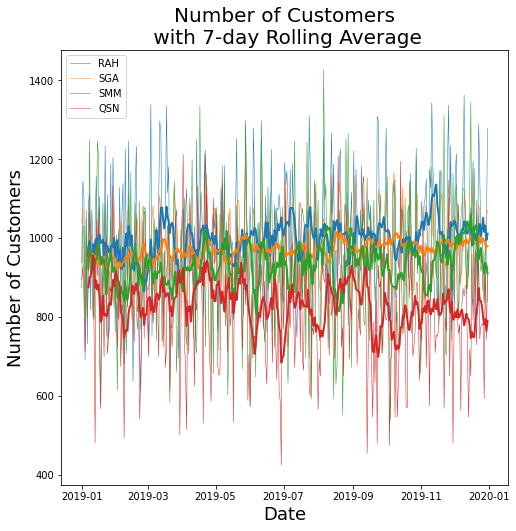

In [30]:
period = 7
rolling_average = NumberOfCustomers_data.rolling(window=period).mean()


plt.figure(figsize=(8, 8))
plt.plot(NumberOfCustomers_data[selectedHigh], linewidth=0.5)
plt.gca().set_prop_cycle(None)
plt.plot(rolling_average[selectedHigh], linewidth=2)
# plt.ylim(ymin=0)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Number of Customers', fontsize=18)
plt.title('Number of Customers\n with 7-day Rolling Average', fontsize=20)
plt.legend(selected, loc=2)
plt.show()

#I am plotting a rolling average for 7 days for a Medium number of Customers, which has not been added due to lack of clarity.



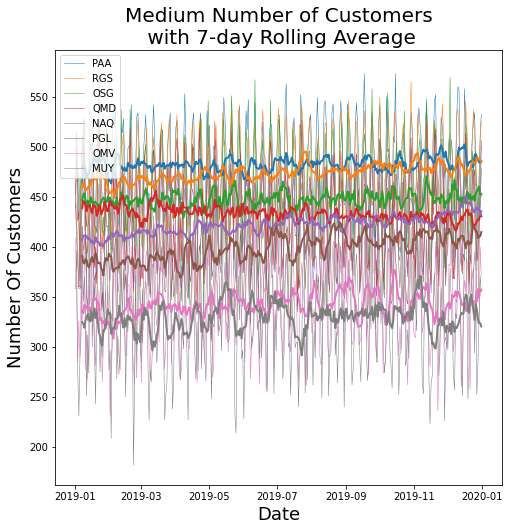

In [31]:
period = 7
rolling_average = NumberOfCustomers_data.rolling(window=period).mean()


plt.figure(figsize=(8, 8))
plt.plot(NumberOfCustomers_data[selectedMedium], linewidth=0.5)
plt.gca().set_prop_cycle(None)
plt.plot(rolling_average[selectedMedium], linewidth=2)
# plt.ylim(ymin=0)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Number Of Customers', fontsize=18)
plt.title('Medium Number of Customers\n with 7-day Rolling Average', fontsize=20)
plt.legend(selectedMedium, loc=2)
plt.show()


#I tried to incorporate trendlines along with the rolling average, but the figure lacks appropriate information, which is why it is not added.


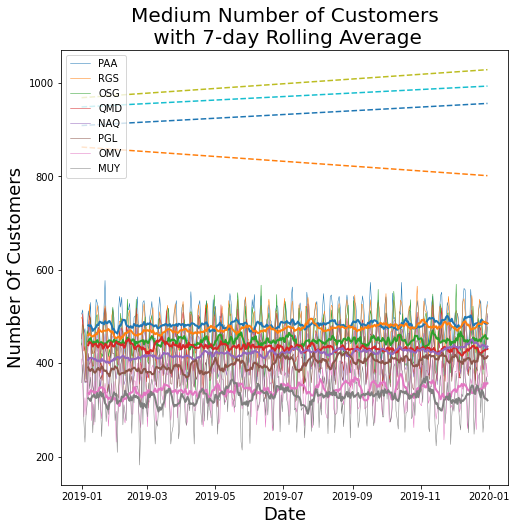

In [32]:
plt.figure(figsize=(8, 8))
plt.plot(NumberOfCustomers_data[selectedMedium], linewidth=0.5)
plt.gca().set_prop_cycle(None)
plt.plot(rolling_average[selectedMedium], linewidth=2)
# plt.ylim(ymin=0)
for name in selected:
    x = np.arange(len(NumberOfCustomers_data[name]))
    z = np.polyfit(x, NumberOfCustomers_data[name], 1)
    trend = np.poly1d(z)
    plt.plot(NumberOfCustomers_data.index, trend(x), linestyle='--')
plt.xlabel('Date', fontsize=18)
plt.ylabel('Number Of Customers', fontsize=18)
plt.title('Medium Number of Customers\n with 7-day Rolling Average', fontsize=20)
plt.legend(selectedMedium, loc=2)
plt.show()



#**Visualisation:2**
#This visualisation gives a clear understanding of the trendlines for the stores with a medium number of customers, which is why I have included it in the report. It is also visually attractive.


<function matplotlib.pyplot.show>

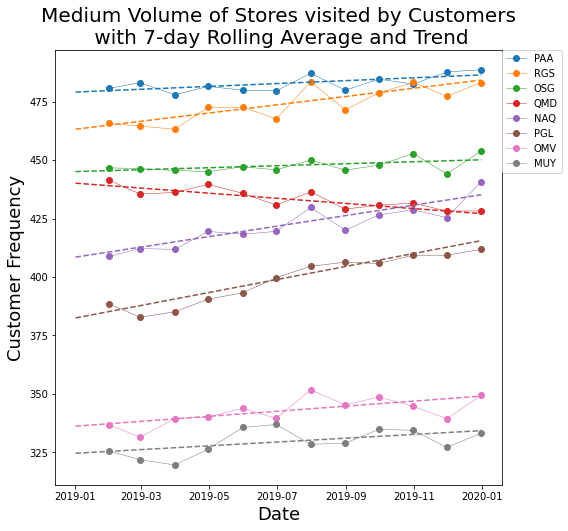

In [33]:

sample_rate = 'M'  
averaged_data = NumberOfCustomers_data.resample(sample_rate).mean()
period = 7
rolling_average = NumberOfCustomers_data.rolling(window=period).mean()
#selected = ['PAA', 'OSG','RGS','QMD','NAQ','PGL','OMV','MUY']

#print(data[selected].head())
#print(data[selected].head())

plt.figure(figsize=(8, 8))
plt.plot(averaged_data[selectedMedium], linewidth=0.5,marker='o')
plt.gca().set_prop_cycle(None)
for name in selectedMedium:
    x = np.arange(len(NumberOfCustomers_data[name]))
    z = np.polyfit(x, NumberOfCustomers_data[name], 1)
    trend = np.poly1d(z)
    plt.plot(NumberOfCustomers_data.index, trend(x), linestyle='--')
#plt.ylim(ymin=0)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customer Frequency', fontsize=18)
plt.title('Medium Volume of Stores visited by Customers\n with 7-day Rolling Average and Trend', fontsize=20)
plt.legend(selectedMedium,bbox_to_anchor=(1.00,1), loc=2, borderaxespad=0.)
plt.show

#I wanted to see whether new stores have been opened or closed down during that year which is why I used this visualisation. However, I have not included it in the sample report as there is a limitation of using visualisation. Still, I have managed to utilize the information in the data conclusion.

('NMO', 'AEI', 'NGB', 'YYO', 'ZSD', 'MAj')

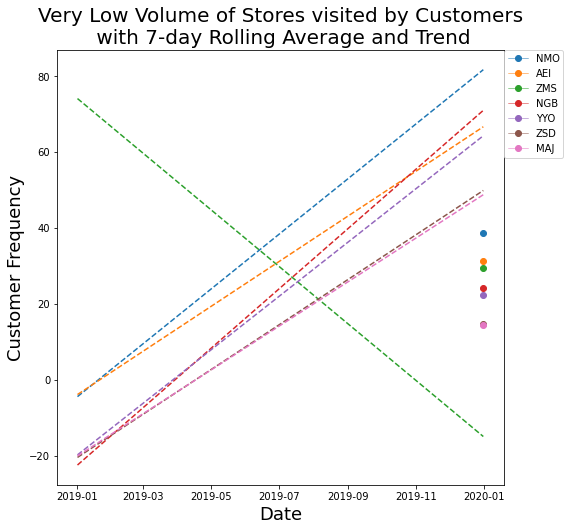

In [34]:
SelectedVeryLow = NumberOfCustomers_data.columns[NumberOfCustomers_data.sum() < 15000]

sample_rate = 'Y'  
averaged_data = NumberOfCustomers_data.resample(sample_rate).mean()
period = 7
rolling_average = NumberOfCustomers_data.rolling(window=period).mean()


plt.figure(figsize=(8, 8))
plt.plot(averaged_data[SelectedVeryLow], linewidth=0.5,marker='o')
plt.gca().set_prop_cycle(None)
for name in SelectedVeryLow:
    x = np.arange(len(NumberOfCustomers_data[name]))
    z = np.polyfit(x, NumberOfCustomers_data[name], 1)
    trend = np.poly1d(z)
    plt.plot(NumberOfCustomers_data.index, trend(x), linestyle='--')
#plt.ylim(ymin=0)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Customer Frequency', fontsize=18)
plt.title('Very Low Volume of Stores visited by Customers\n with 7-day Rolling Average and Trend', fontsize=20)
plt.legend(SelectedVeryLow,bbox_to_anchor=(1.00,1), loc=2, borderaxespad=0.)
plt.show
"NMO","AEI","NGB","YYO","ZSD","MAj"

#I want to observe the correlation between the stores with a higher number of customers, which is why the Scatter plot has been introduced. As there is no correlation, I did not include it in the report.





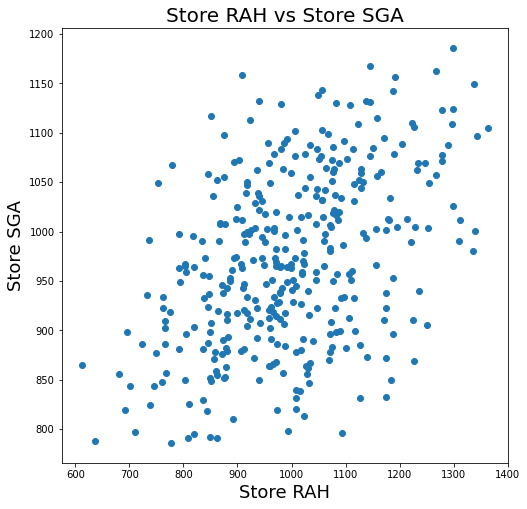

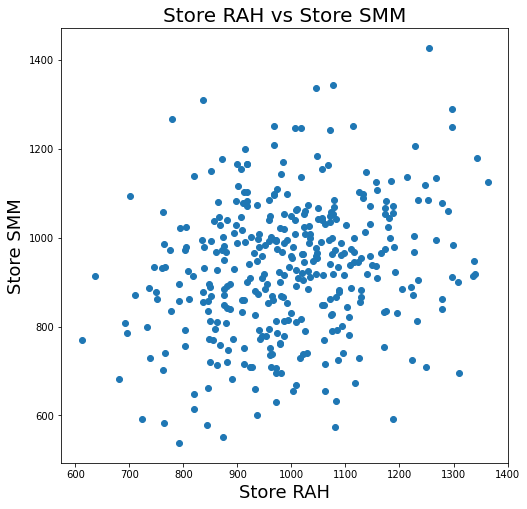

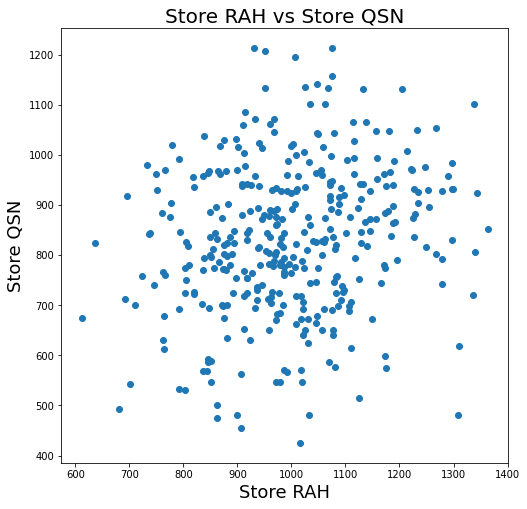

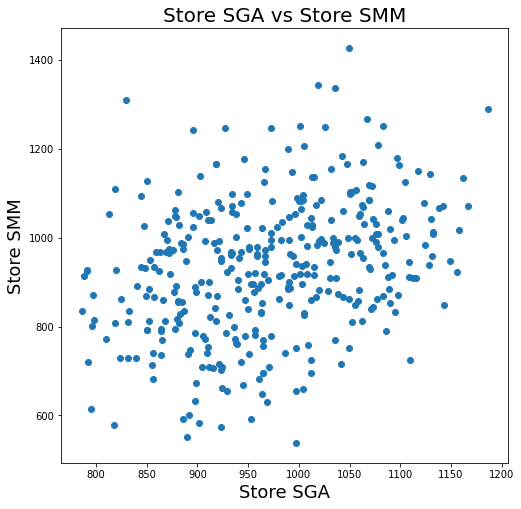

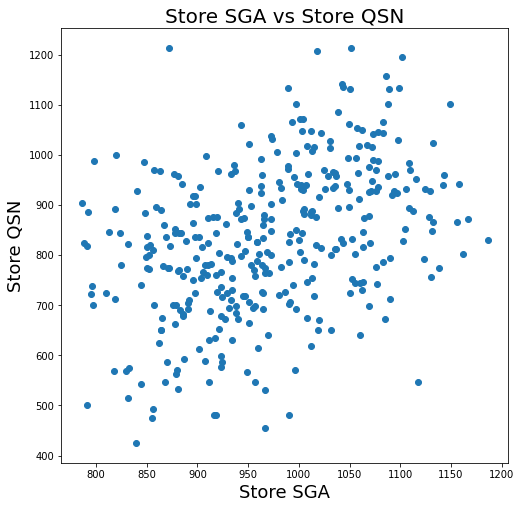

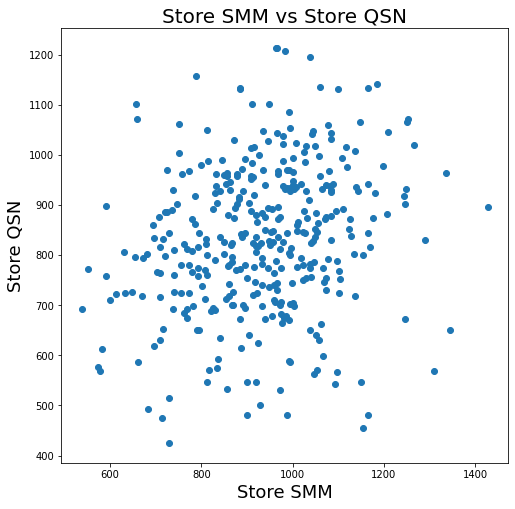

In [35]:

for i, name_i in enumerate(selectedHigh):
    for j in range(i + 1, len(selectedHigh)):
        name_j = selectedHigh[j]
        plt.figure(figsize=(8, 8))
        plt.scatter(NumberOfCustomers_data[name_i], NumberOfCustomers_data[name_j])
        plt.title('Store ' + name_i + ' vs Store ' + name_j, fontsize=20)
        plt.xlabel('Store ' + name_i, fontsize=18)
        plt.ylabel('Store ' + name_j, fontsize=18)
        plt.show()



#I want to observe the correlation between the stores with a medium number of customers, which is why the Scatter plot has been introduced.I did not include it in the report as there are too much information.





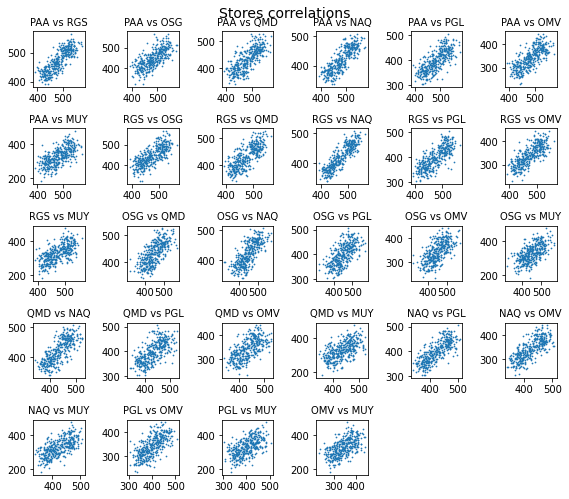

In [36]:
counter = 1
fig = plt.figure(figsize=(8, 8))
fig.suptitle('Stores correlations', fontsize=14, position=(0.5, 1.0))
for i, name_i in enumerate(selectedMedium):
    for j in range(i + 1, len(selectedMedium)):
        name_j = selectedMedium[j]
        sub = fig.add_subplot(6, 6, counter)
        sub.set_title(name_i + ' vs ' + name_j, fontsize=10)
        sub.scatter(NumberOfCustomers_data[name_i], NumberOfCustomers_data[name_j], s=0.5)
        counter += 1
plt.subplots_adjust(wspace=0.5, hspace=0.5)
plt.tight_layout()
plt.show()

RGS and NAQ are strongly correlated with each other


#To further investigate correlation, HeatMaps for High and Medium stores has been introduced. However, I have not added as I have found better visualisation than this plot.


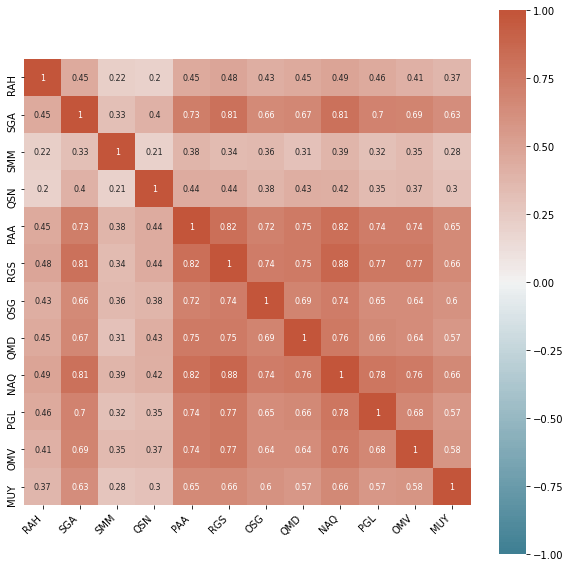

In [37]:
selectedHM = ['RAH','SGA','SMM','QSN'] + ['PAA','RGS','OSG','QMD','NAQ','PGL','OMV','MUY']
#selected = data.columns[data.sum() > 10000]

plt.figure(figsize=(10, 10))
corr = NumberOfCustomers_data[selectedHM].corr()
ax = sns.heatmap(corr, vmin=-1, vmax=1, center=0, cmap=sns.diverging_palette(220, 20, n=200), square=True, annot=True,
                 annot_kws={"size": 8})
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.show()


#To simply observe the correlated stores,LinePlot for selected coorelated stores has been plotted which lacks clarity.





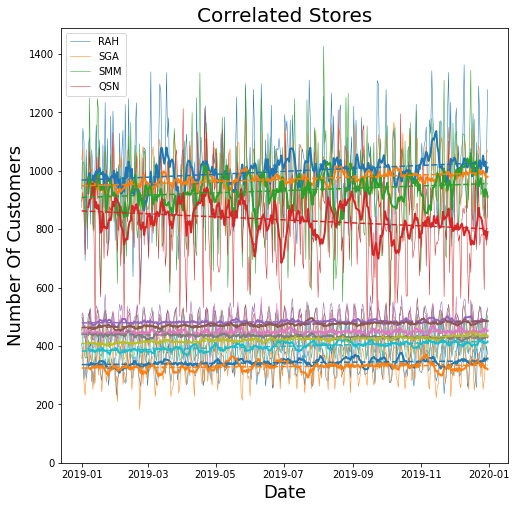

In [38]:
period = 7
rolling_average = NumberOfCustomers_data.rolling(window=period).mean()


plt.figure(figsize=(8, 8))
plt.plot(NumberOfCustomers_data[selectedHM], linewidth=0.5)
plt.gca().set_prop_cycle(None)
plt.plot(rolling_average[selectedHM], linewidth=2)
plt.gca().set_prop_cycle(None)
for name in selectedHM:
    x = np.arange(len(NumberOfCustomers_data[name]))
    z = np.polyfit(x, NumberOfCustomers_data[name], 1)
    trend = np.poly1d(z)
    plt.plot(NumberOfCustomers_data.index, trend(x), linestyle='--')
plt.ylim(ymin=0)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Number Of Customers', fontsize=18)
plt.title('Correlated Stores', fontsize=20)
plt.legend(selected, loc=2)
plt.show()


#**Visualisation:3**
#This visualisation gives a clear understanding of the distribution and outliers of stores for Higher number of customers store which is why I have chosen this plot. 





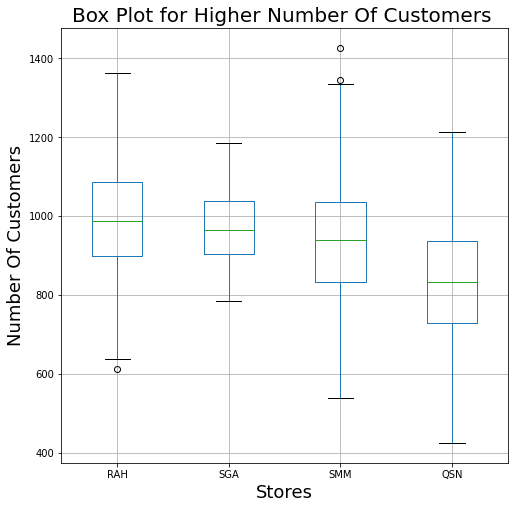

In [39]:
plt.figure(figsize=(8, 8))
NumberOfCustomers_data[selected].boxplot()
#plt.boxplot(NumberOfCustomers_data[selected],labels=selected)
plt.xlabel('Stores', fontsize=18)
plt.ylabel('Number Of Customers', fontsize=18)
plt.title('Box Plot for Higher Number Of Customers ', fontsize=20)
plt.show()


#This visualisation gives a clear understanding of the distribution and outliers of stores for a Medium number of customers store but I did not include it as I have checked trendlines for stores with a medium number of customers.

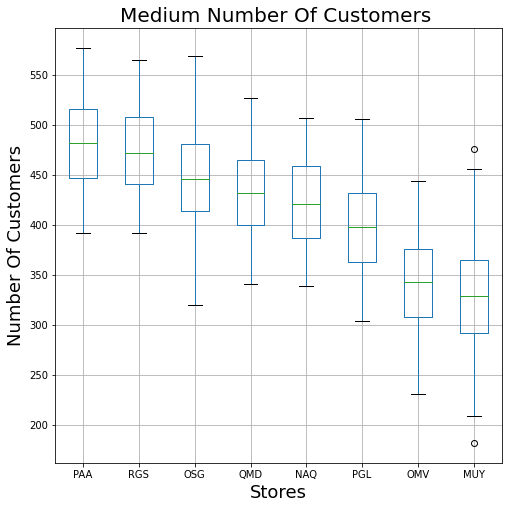

In [40]:
plt.figure(figsize=(8, 8))
NumberOfCustomers_data[selectedMedium].boxplot()
#plt.boxplot(NumberOfCustomers_data[selected],labels=selected)
plt.xlabel('Stores', fontsize=18)
plt.ylabel('Number Of Customers', fontsize=18)
plt.title('Medium Number Of Customers ', fontsize=20)
plt.show()

#This visualisation gives a clear understanding of the distribution of stores for Higher number of customers store but I did not choose this plot as I have chosen the histogram with interaction. 


11 bins


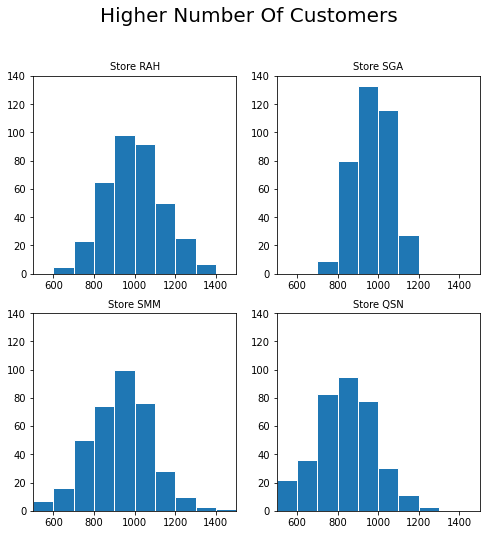

In [41]:
x_min = 500
x_max = 1500
bin_width = 100

n_bins = int((bin_width + x_max - x_min) / bin_width)
print(str(n_bins) + ' bins')
bins = [(x_min + x * (bin_width + x_max - x_min) / n_bins) for x in range(int(n_bins))]

fig = plt.figure(figsize=(8, 8))
fig.suptitle('Higher Number Of Customers', fontsize=20, position=(0.5, 1.0))
counter = 1
for name in selectedHigh:
    sub = fig.add_subplot(2, 2, counter)
    sub.hist(NumberOfCustomers_data[name], bins, edgecolor='w')
    sub.set_title('Store ' + name, fontsize=10)
    sub.set_xlim(xmin=x_min, xmax=x_max)
    sub.set_ylim(ymin=0, ymax=140)
    counter += 1
# plt.subplots_adjust(wspace=0.4, hspace=0.4)
plt.show()


#This visualisation gives a clear understanding of the distribution of stores for a Medium number of customers store but I did not choose this plot as I have chosen the histogram with interaction.


9 bins


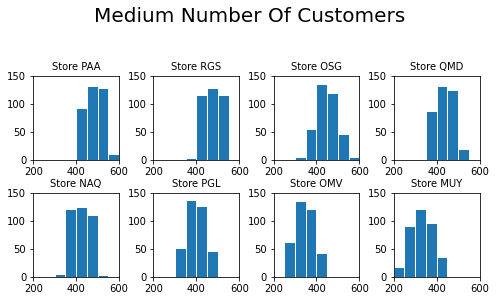

In [42]:
x_min = 200
x_max = 600
bin_width = 50

n_bins = int((bin_width + x_max - x_min) / bin_width)
print(str(n_bins) + ' bins')
bins = [(x_min + x * (bin_width + x_max - x_min) / n_bins) for x in range(int(n_bins))]

fig = plt.figure(figsize=(8, 8))
fig.suptitle('Medium Number Of Customers', fontsize=20, position=(0.5, 1.0))
counter = 1
for name in selectedMedium:
    sub = fig.add_subplot(4, 4, counter)
    sub.hist(NumberOfCustomers_data[name], bins, edgecolor='w')
    sub.set_title('Store ' + name, fontsize=10)
    sub.set_xlim(xmin=x_min, xmax=x_max)
    sub.set_ylim(ymin=0, ymax=150)
    counter += 1
plt.subplots_adjust(wspace=0.4, hspace=0.4)
plt.show()


#Now, I am interested to find the properties of both stores with a medium and higher number of customers. However, I have not found any.




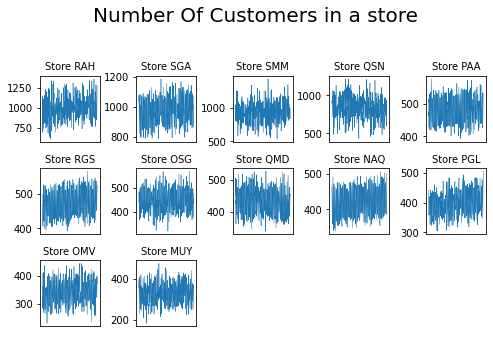

In [43]:

counter = 1
fig = plt.figure(figsize=(8, 8))
fig.suptitle('Number Of Customers in a store', fontsize=20, position=(0.5, 1.0))
for name in selectedHM:
    sub = fig.add_subplot(5, 5, counter)
    sub.set_title('Store ' + name, fontsize=10)
    sub.plot(NumberOfCustomers_data.index, NumberOfCustomers_data[name], linewidth=0.5)
    sub.axes.get_xaxis().set_ticks([])  # remove the x ticks
    counter += 1
plt.subplots_adjust(wspace=0.6, hspace=0.4)
plt.show()



#I am interested to check for autocorrelation of the stores with a higher number of Customers. This has not been added but useful information about the stores can be gained.

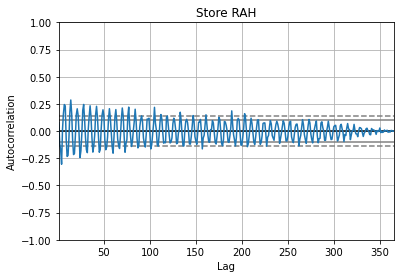

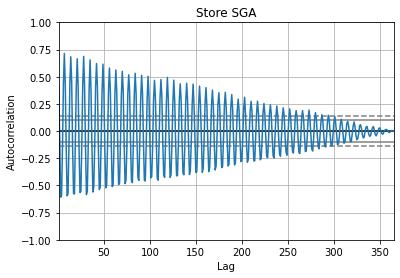

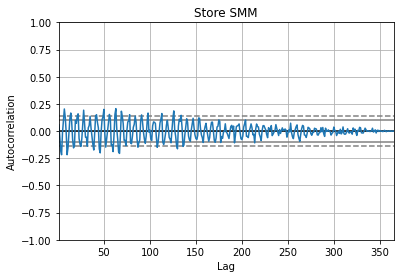

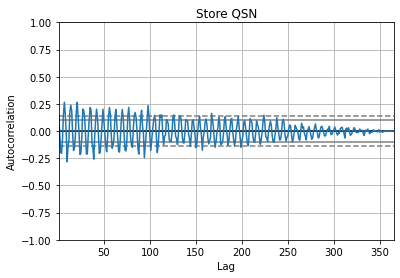

In [44]:

for name in selectedHigh:
    pd.plotting.autocorrelation_plot(NumberOfCustomers_data[name])
    # plt.xlim([0, 50]) # uncomment this line to zoom in
    plt.title('Store ' + name)
    plt.show()

#I am interested to check for autocorrelation of the stores with a medium number of Customers. This has not been added but useful information about the stores can be gained.








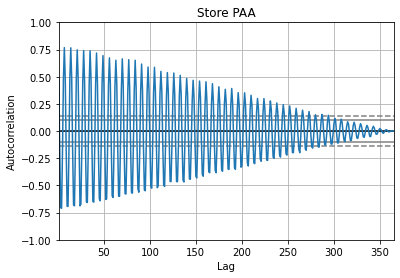

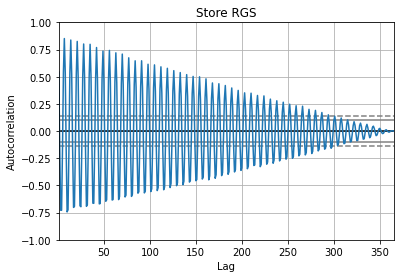

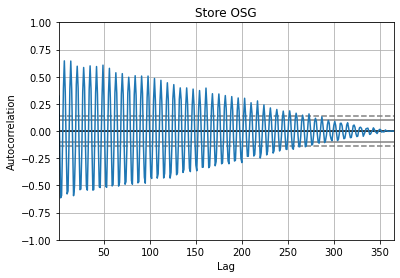

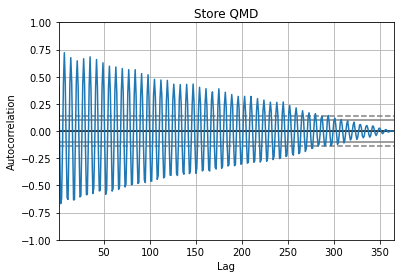

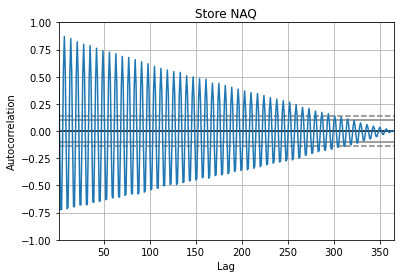

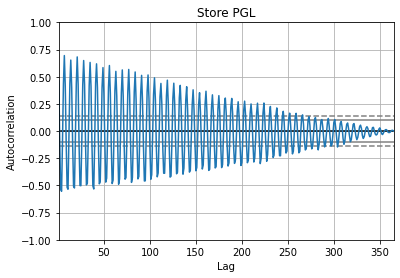

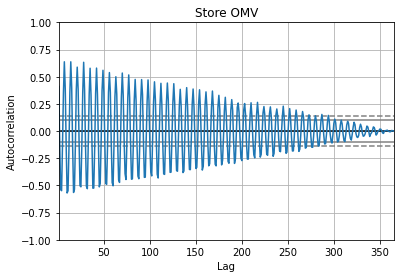

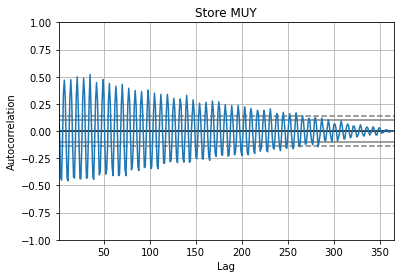

In [45]:

for name in selectedMedium:
    pd.plotting.autocorrelation_plot(NumberOfCustomers_data[name])
    # plt.xlim([0, 50]) # uncomment this line to zoom in
    plt.title('Store ' + name)
    plt.show()




#**Visualisation:6**
#This visualisation gives a clear understanding of the seasonality of the stores which is why I have chosen this plot. I have maintained this order in the report and so it is visualisation 6.


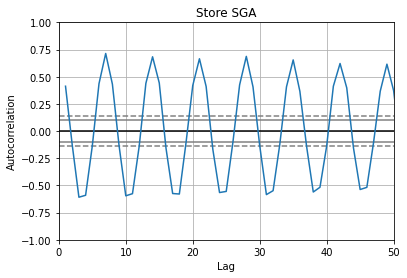

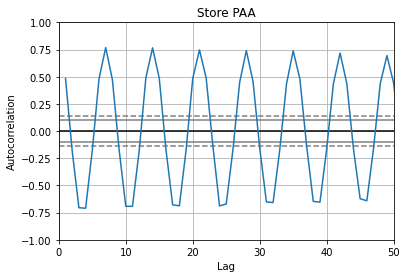

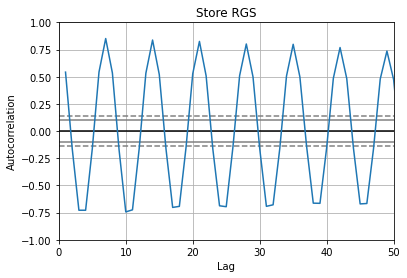

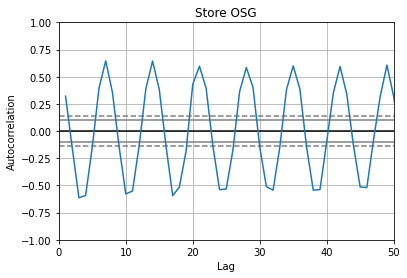

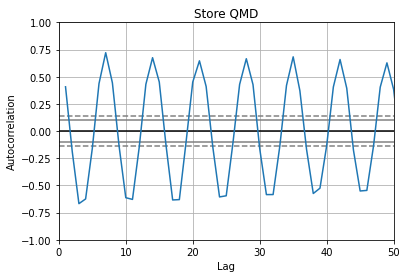

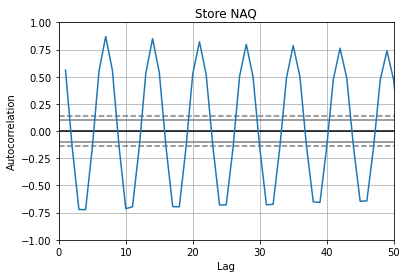

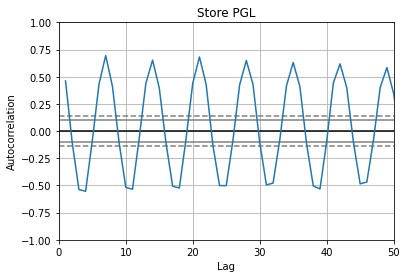

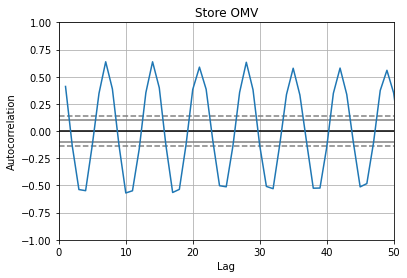

In [46]:
selectedSeasonality = ['SGA','PAA','RGS','OSG','QMD','NAQ','PGL','OMV']
                       
for name in selectedSeasonality:
    pd.plotting.autocorrelation_plot(NumberOfCustomers_data[name])
    plt.xlim([0, 50]) # uncomment this line to zoom in
    plt.title('Store ' + name)
    plt.show()

#Bar Chart for all attributes have been plotted which does not portray meaningful insights.

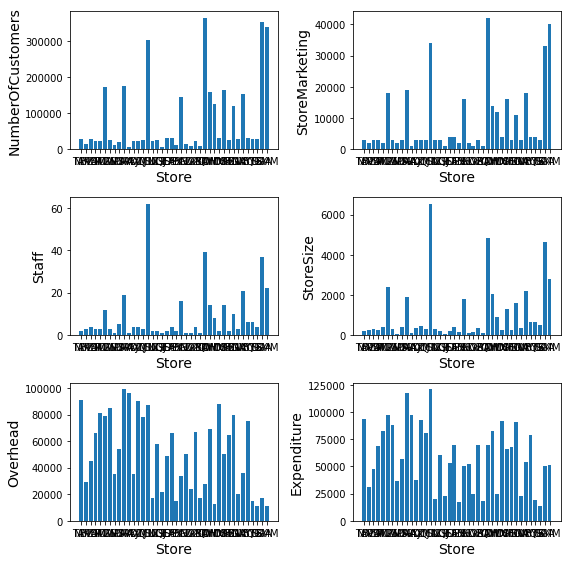

In [47]:
plt.figure(figsize=(8, 8))
counter = 1
x_pos = np.arange(len(summary_data.index))
for attribute in summary_data:
    sub = plt.subplot(3, 2, counter)
    sub.bar(x_pos, summary_data[attribute], align='center')
    sub.set_xticks([])
    sub.set_xticks(x_pos)
    sub.set_xticklabels(summary_data.index)
    sub.set_xlabel('Store', fontsize=14)
    sub.set_ylabel(attribute, fontsize=14)
    counter += 1
plt.tight_layout()
plt.show()


#Radar plot for the store with higher number of Customers has been implemented but not chosen for the report has overlaid radar plot gives better understanding.

     NumberOfCustomers  StoreMarketing  ...  Overhead  Expenditure
TAP           0.078557        0.071429  ...  0.919192     0.776860
NMO           0.038730        0.047619  ...  0.292929     0.256198
BZM           0.077594        0.071429  ...  0.454545     0.396694
VSM           0.067043        0.071429  ...  0.666667     0.570248
ATT           0.065114        0.047619  ...  0.818182     0.685950

[5 rows x 6 columns]


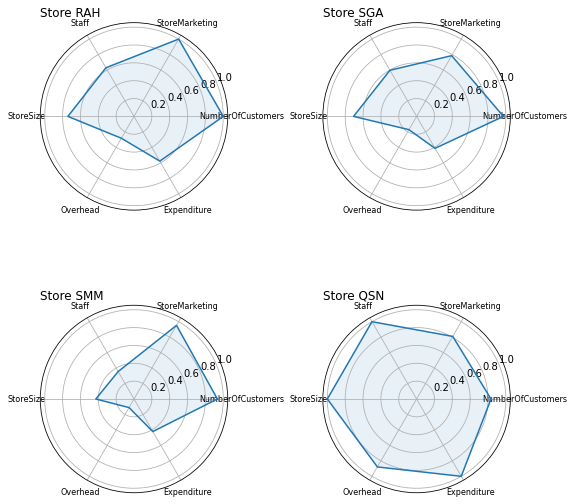

In [48]:
normalised_data = summary_data / summary_data.max()
print(normalised_data.head())


n_attributes = len(normalised_data.columns)
angles = [n / float(n_attributes) * 2 * np.pi for n in range(n_attributes + 1)]
plt.figure(figsize=(8, 8))
counter = 1
for name in selectedHigh:
    values = normalised_data.loc[[name]].values.flatten().tolist()
    values += values[:1]
    sub = plt.subplot(2, 2, counter, polar=True)
    sub.plot(angles, values)
    sub.fill(angles, values, alpha=0.1)
    sub.set_ylim(ymax=1.05)
    sub.set_yticks([0.2, 0.4, 0.6, 0.8, 1.0])
    sub.set_xticks(angles[0:-1])
    sub.set_xticklabels(normalised_data.columns, fontsize=8)
    sub.set_title('Store ' + name, fontsize=12, loc='left')
    counter += 1
plt.tight_layout()
plt.show()




#**Visualisation:4**
#This visualisation gives a clear understanding of the summary data for the stores with a higher number of customers. 

     NumberOfCustomers  StoreMarketing  ...  Overhead  Expenditure
TAP           0.078557        0.071429  ...  0.919192     0.776860
NMO           0.038730        0.047619  ...  0.292929     0.256198
BZM           0.077594        0.071429  ...  0.454545     0.396694
VSM           0.067043        0.071429  ...  0.666667     0.570248
ATT           0.065114        0.047619  ...  0.818182     0.685950

[5 rows x 6 columns]


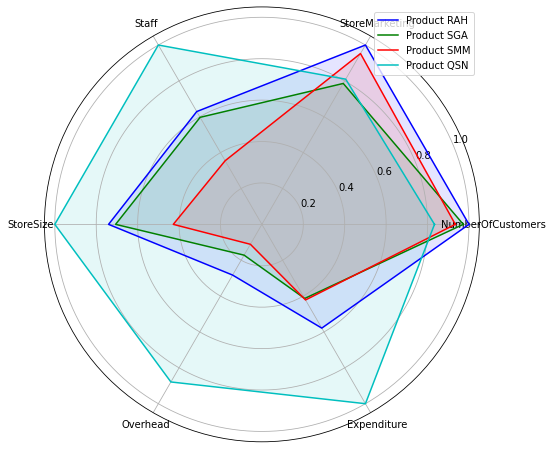

In [49]:
normalised_data = summary_data / summary_data.max()
print(normalised_data.head())

n_attributes = len(normalised_data.columns)
angles = [n / float(n_attributes) * 2 * np.pi for n in range(n_attributes + 1)]
colours = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'w']
c = 0
plt.figure(figsize=(8, 8))
sub = plt.subplot(1, 1, 1, polar=True)
for name in selectedHigh:
    values = normalised_data.loc[[name]].values.flatten().tolist()
    values += values[:1]
    sub.plot(angles, values, colours[c % len(colours)], label='Product ' + name)
    sub.fill(angles, values, colours[c % len(colours)], alpha=0.1)
    sub.set_ylim(ymax=1.05)
    sub.set_yticks([0.2, 0.4, 0.6, 0.8, 1.0])
    sub.set_xticks(angles[0:-1])
    sub.set_xticklabels(normalised_data.columns)
    c += 1
plt.legend(loc=1)
plt.show()


#Radar plot for the store with a medium number of Customers has been implemented but not chosen for the report as the plot is not clear to understand.

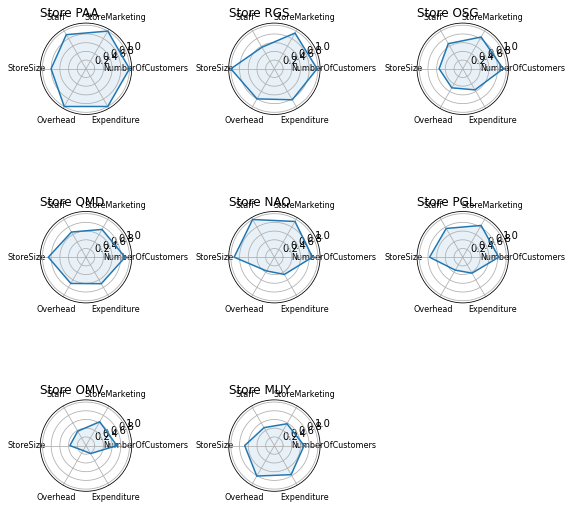

In [50]:
normalised_data = summary_data / summary_data.loc[selectedMedium].max()
n_attributes = len(normalised_data.columns)
angles = [n / float(n_attributes) * 2 * np.pi for n in range(n_attributes + 1)]
plt.figure(figsize=(8, 8))
counter = 1
for name in selectedMedium:
    values = normalised_data.loc[[name]].values.flatten().tolist()
    values += values[:1]
    sub = plt.subplot(3, 3, counter, polar=True)
    sub.plot(angles, values)
    sub.fill(angles, values, alpha=0.1)
    sub.set_ylim(ymax=1.05)
    sub.set_yticks([0.2, 0.4, 0.6, 0.8, 1.0])
    sub.set_xticks(angles[0:-1])
    sub.set_xticklabels(normalised_data.columns, fontsize=8)
    sub.set_title('Store ' + name, fontsize=12, loc='left')
    counter += 1
plt.tight_layout()
plt.show()



Store NAQ have bigger store size and greater number of stuffs

#Pair plot/correlogram has been introduced to inspect the correlation but not included in the report as there are too many information.

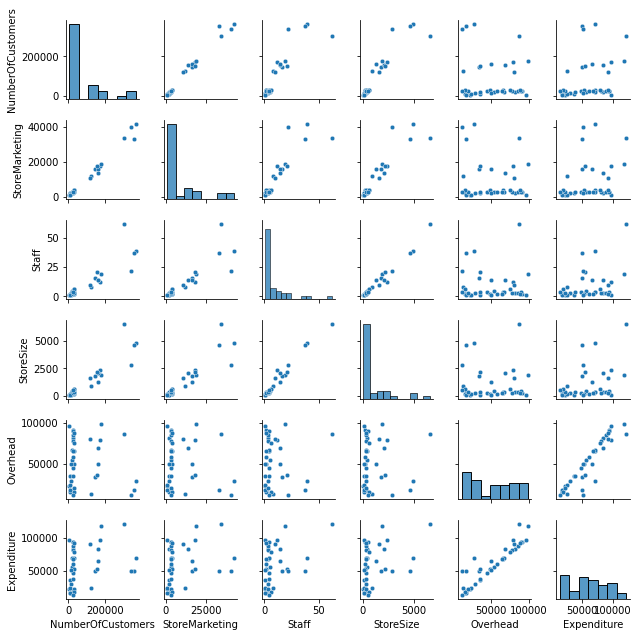

In [51]:
sns.pairplot(summary_data, height=1.5, plot_kws={'s': 20})
plt.show()


Staff is related to the store size and overhead is related to the expenditure.


#**Visualisation:5**
#This visualisation gives a clear understanding of the correlation between summary data for the stores which is why it is added in the report.

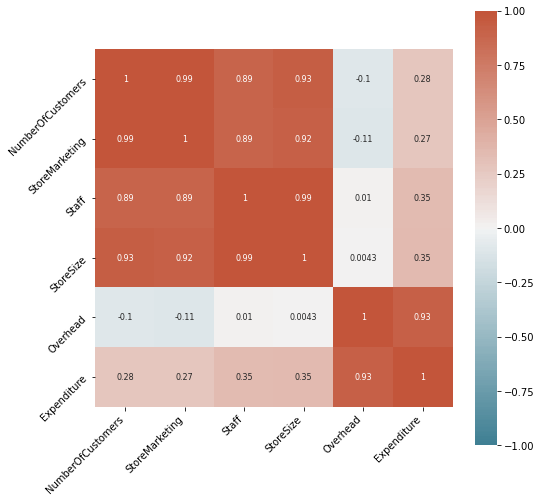

In [52]:
plt.figure(figsize=(8, 8))
corr = summary_data.corr()
ax = sns.heatmap(corr, vmin=-1, vmax=1, center=0, cmap=sns.diverging_palette(220, 20, n=200), square=True, annot=True,
                 annot_kws={"size": 8})
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right')
ax.set_yticklabels(ax.get_yticklabels(), rotation=45, horizontalalignment='right')
plt.show()


Store size and the number of staffs are strongly coorelated with each other.

# Bubble Plot for stores with higher number of customers related to StoreSize, StoreMarketing and Staff has been plotted but not added in the report as I have chosen the interactive one.
 


---





No handles with labels found to put in legend.


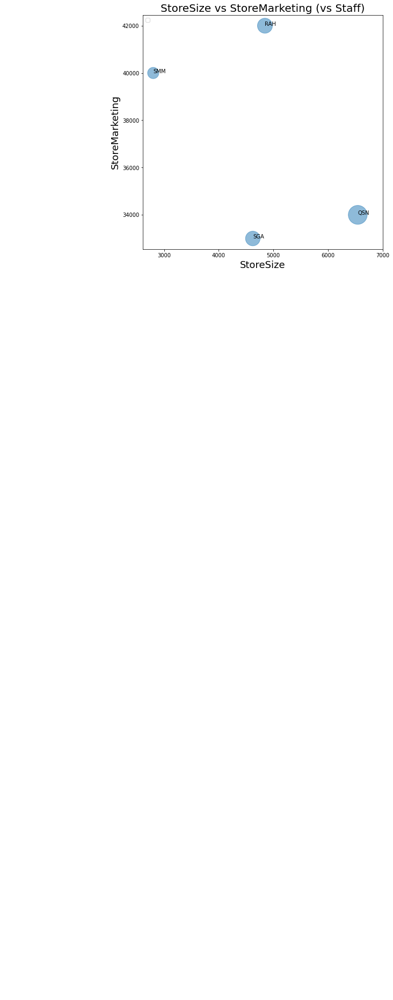

In [53]:
summary_dataBubble = summary_data.loc[selectedHigh]
summary_dataBubble['BubbleSize'] = summary_data['Staff'] * 20

plt.figure(figsize=(8, 8))
plt.scatter(summary_dataBubble['StoreSize'], summary_dataBubble['StoreMarketing'], s=summary_dataBubble['BubbleSize'], alpha=0.5)
plt.xticks([3000, 4000, 5000, 6000, 7000])
# plt.yticks([10, 20, 30, 40, 50])
plt.title('StoreSize vs StoreMarketing (vs Staff)', fontsize=20)
plt.xlabel('StoreSize', fontsize=18)
plt.ylabel('StoreMarketing', fontsize=18)
for i, name in enumerate(summary_data.index):
  plt.annotate(name, (summary_data['StoreSize'][i], summary_data['StoreMarketing'][i]))
# plt.plot([0, 50], [0, 50], linestyle=':', color='r', label='StoreSize = StoreMarketing (zero Staff)')
plt.legend(loc=2)
plt.show()



# Bubble Plot for stores with a medium number of customers related to Number of customers, StorecMarketing and Staff has been plotted but not added in the report as I have chosen the interactive one.


No handles with labels found to put in legend.


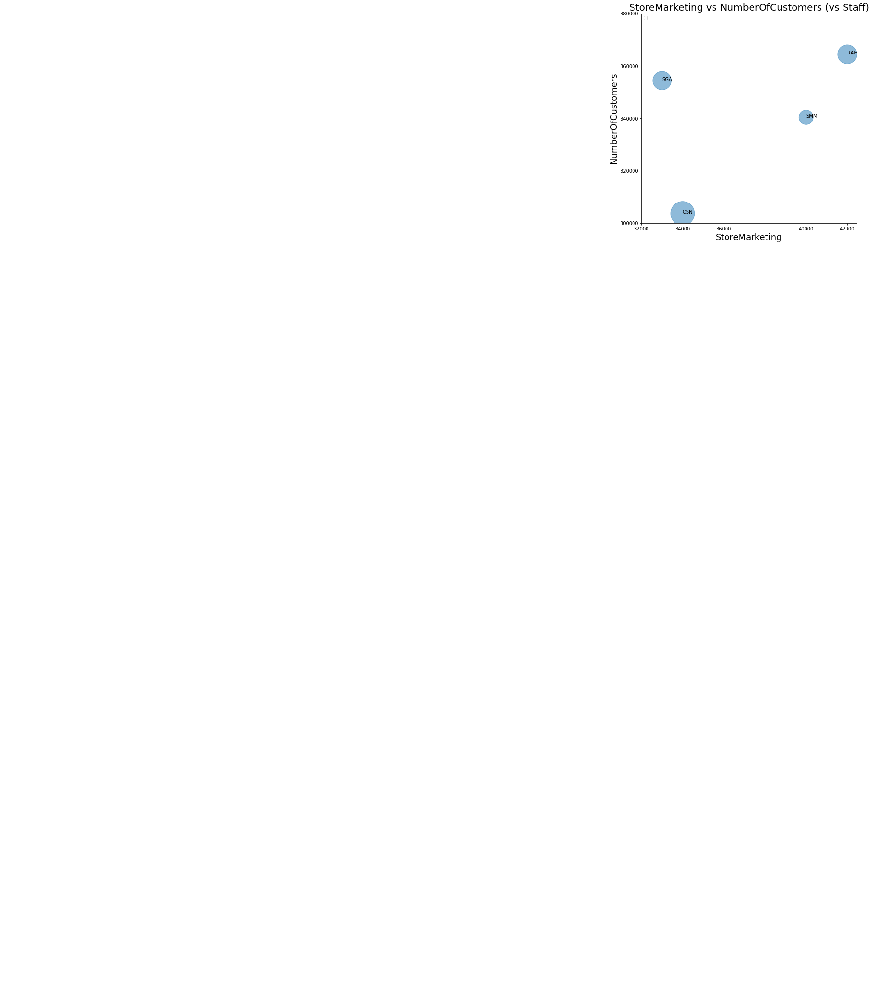

In [54]:
summary_dataBubble = summary_data.loc[selectedHigh]
summary_dataBubble['BubbleSize'] = summary_data['Staff'] * 40

plt.figure(figsize=(8, 8))
plt.scatter(summary_dataBubble['StoreMarketing'], summary_dataBubble['NumberOfCustomers'], s=summary_dataBubble['BubbleSize'], alpha=0.5)
plt.xticks([32000,34000,36000,40000,42000])
plt.yticks([300000, 320000, 340000, 360000, 380000])
plt.title('StoreMarketing vs NumberOfCustomers (vs Staff)', fontsize=20)
plt.xlabel('StoreMarketing', fontsize=18)
plt.ylabel('NumberOfCustomers', fontsize=18)
for i, name in enumerate(summary_data.index):
  plt.annotate(name, (summary_data['StoreMarketing'][i], summary_data['NumberOfCustomers'][i]))
# plt.plot([0, 50], [0, 50], linestyle=':', color='r', label='StoreSize = StoreMarketing (zero Staff)')
plt.legend(loc=2)
plt.show()


# Bubble Plot for stores with a medium number of customers related to StoreSize, StoreMarketing and Staff has been plotted but not added in the report as I have chosen the interactive one.


Bubble Plot for stores with medium number of customers 
related to related to StoreSize, StoreMarketing and Staff.

No handles with labels found to put in legend.


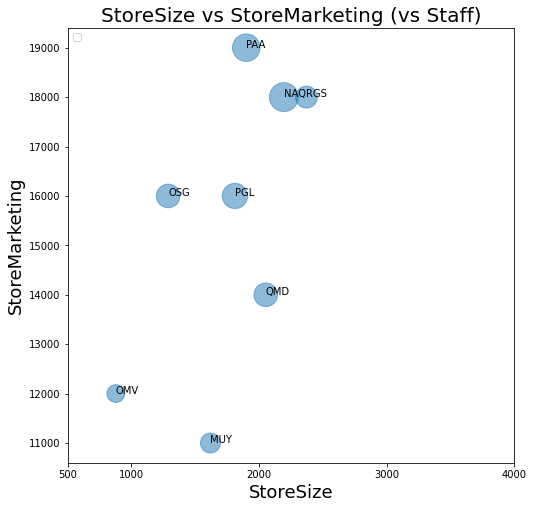

In [55]:
summary_dataBubble = summary_data.loc[selectedMedium]
summary_dataBubble['BubbleSize'] = summary_data['Staff'] * 40

plt.figure(figsize=(8, 8))
plt.scatter(summary_dataBubble['StoreSize'], summary_dataBubble['StoreMarketing'], s=summary_dataBubble['BubbleSize'], alpha=0.5)
plt.xticks([500,1000,2000,3000, 4000])
# plt.yticks([10, 20, 30, 40, 50])
plt.title('StoreSize vs StoreMarketing (vs Staff)', fontsize=20)
plt.xlabel('StoreSize', fontsize=18)
plt.ylabel('StoreMarketing', fontsize=18)
for i, name in enumerate(summary_dataBubble.index):
  plt.annotate(name, (summary_dataBubble['StoreSize'][i], summary_dataBubble['StoreMarketing'][i]))
# plt.plot([0, 50], [0, 50], linestyle=':', color='r', label='StoreSize = StoreMarketing (zero Staff)')
plt.legend(loc=2)
plt.show()




#Interaction- line plot has been added to view the data more accurately but I have not chosen it as I have already mentioned one line plot in the report.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
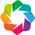

:NdOverlay   [Variable]
   :Curve   [Date]   (value)

In [56]:
plot = NumberOfCustomers_data.hvplot.line(
    frame_height=500, frame_width=500,
    xlabel='Date', ylabel='Number Of Customers',
    title='All Stores'
)
hv.extension('bokeh')
plot


#Line plot for the stores with higher number of customers

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
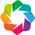

:NdOverlay   [Variable]
   :Curve   [Date]   (value)

In [57]:
plot = NumberOfCustomers_data[selectedHigh].hvplot.line(
    frame_height=500, frame_width=500,
    xlabel='Date', ylabel='Number Of Customers',
    title='Stores with higher number of customers'
)
hv.extension('bokeh')
plot


#**Visualisation:7**
#This visualisation gives a clear understanding of the distribution of the stores with a high and medium number of customers which is why it is added in the report.

23 bins


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
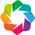

:NdOverlay   [Element]
   :Histogram   [MUY]   (MUY_count)

In [58]:
x_min = 400
x_max = 1500
bin_width = 50
n_bins = int((bin_width + x_max - x_min) / bin_width)
print(str(n_bins) + ' bins')
bins = [(x_min + x * (bin_width + x_max - x_min) / n_bins) for x in range(int(n_bins))]

plot = NumberOfCustomers_data[selectedHM].hvplot.hist(
    frame_height=500, frame_width=500,
    xlabel='Number Of Customers', ylabel='Frequency',
    title='Stores with High and Medium Number of Customers',
    alpha=0.5, muted_alpha=0, muted_fill_alpha=0, muted_line_alpha=0,
    tools=['pan', 'box_zoom', 'wheel_zoom', 'undo', 'redo', 'hover', 'save', 'reset'],
    bins=bins
)

hv.extension('bokeh')
plot


#I have plotted heatmap to visualise the correlation between stores but I have not mentioned it in the report.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
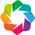

:HeatMap   [columns,index]   (value)

In [59]:
plot = NumberOfCustomers_data.corr().hvplot.heatmap(
    frame_height=500, frame_width=500,
    title='Store correlations',
    rot=90, cmap='coolwarm'  # see http://holoviews.org/user_guide/Colormaps.html
).opts(invert_yaxis=True, clim=(-1, 1))
hv.extension('bokeh')
plot



#The correlation of the store can be observed from heatmap and thus to further investigate it I have used scatter plot. 

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
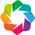

:Layout
   .Scatter.I   :Scatter   [PAA]   (SGA)
   .Scatter.II  :Scatter   [RGS]   (SGA)
   .Scatter.III :Scatter   [RGS]   (NAQ)

In [60]:
xlimits = (300, 700)
ylimits = (750, 1200)
plot = NumberOfCustomers_data.hvplot.scatter(
    frame_height=300, frame_width=300,
    x='PAA', y='SGA', title='PAA vs SGA',
    xlim=xlimits, ylim=ylimits, size=10
) + \
NumberOfCustomers_data.hvplot.scatter(
    frame_height=300, frame_width=300,
    x='RGS', y='SGA', title='RGS vs SGA',
    xlim=xlimits, ylim=ylimits, size=10
) + \
NumberOfCustomers_data.hvplot.scatter(
    frame_height=300, frame_width=300,
    x='RGS', y='NAQ', title='RGS vs NAQ',
    xlim=xlimits, ylim=ylimits, size=10
)



hv.extension('bokeh')
plot



#Further investigation has been done to gain useful insights but have not found from this plot.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
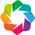

:NdLayout   [Variable]
   :Curve   [Date]   (value)

In [61]:
selectedStore = ['PAA','SGA','NAQ']
plot = NumberOfCustomers_data[selectedStore].hvplot.line(
    frame_height=200, frame_width=600,
    xlabel='Date', ylabel='Number of Customers',
    title='Selected Store',
    tools=['pan', 'box_zoom', 'wheel_zoom', 'undo', 'redo', 'hover', 'save', 'reset'],
    subplots=True
).cols(1)
hv.extension('bokeh')
plot



#**Visualisation:8**
#This visualisation gives a clear understanding of the correlation between the summary data which is why it is added in the report.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
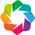

:Scatter   [NumberOfCustomers]   (StoreMarketing,BubbleSize,index,Staff,StoreSize,Overhead,Expenditure)

In [62]:
# summary_data['BubbleSize'] = summary_data['Staff'] * 40
summary_dataBubble = summary_data.loc[selectedHM]
summary_dataBubble['BubbleSize'] = summary_data['StoreSize'] * 0.5

plot = summary_dataBubble.hvplot.scatter(
    frame_height=500, frame_width=500,
    title='Number Of Customers vs Store Marketing (vs Store Size)',
    xlabel='Number Of Customers', ylabel='Store Marketing',
    alpha=0.5, padding=0.1, hover_cols='all',
    tools=['pan', 'box_zoom', 'wheel_zoom', 'undo', 'redo', 'hover', 'save', 'reset'],
    x='NumberOfCustomers', y='StoreMarketing', size='BubbleSize'
)



hv.extension('bokeh')
plot

